In [ ]:
import cv2 as cv
from google.colab.patches import cv2_imshow
!git clone https://github.com/MZMLPE/Imagens
from matplotlib import pyplot as plt
import numpy as np
from google.colab import files


Cloning into 'Imagens'...
remote: Enumerating objects: 48, done.
remote: Counting objects: 100% (9/9), done.
remote: Compressing objects: 100% (9/9), done.
remote: Total 48 (delta 2), reused 0 (delta 0), pack-reused 39 (from 1)
Receiving objects: 100% (48/48), 25.07 MiB | 14.46 MiB/s, done.
Resolving deltas: 100% (5/5), done.


## Métodos de conversão sistemas de cores

In [ ]:
imagem = cv.imread("/content/Imagens/tigre.jpg")
#função cv.cvtColor(imagem, tipo_conversao)
#Em tipo_conversão temos flags que indicam o tipo de conversão
#Por padrão o cv2 recebe a imagem por BGR
#Os dados mudam por pixel (B -> R, G -> G, R -> B)
ImRGB = cv.cvtColor(imagem, cv.COLOR_BGR2RGB)
ImHSV = cv.cvtColor(imagem, cv.COLOR_BGR2HSV)

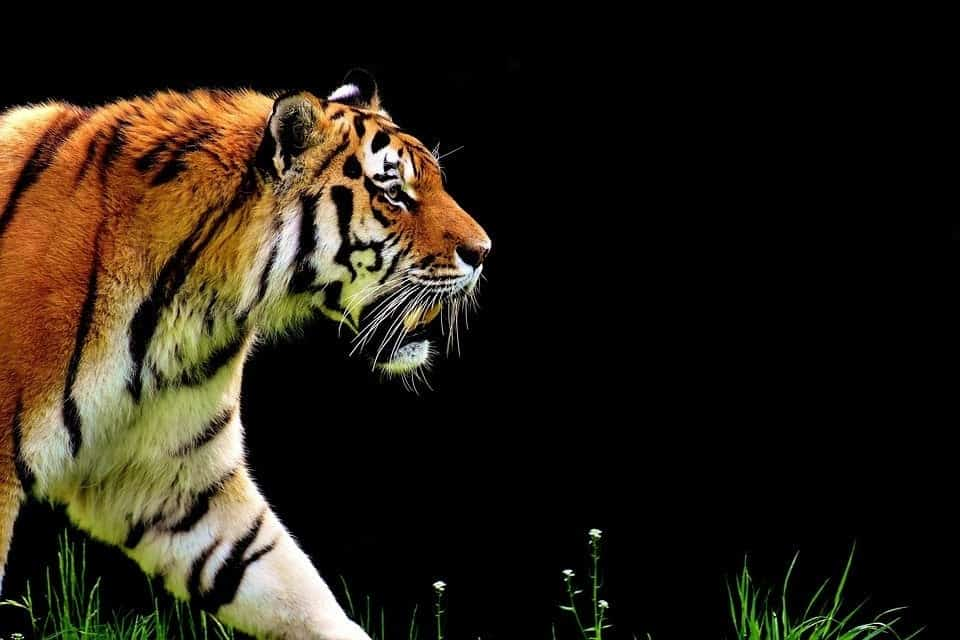

In [ ]:
cv2_imshow(imagem)

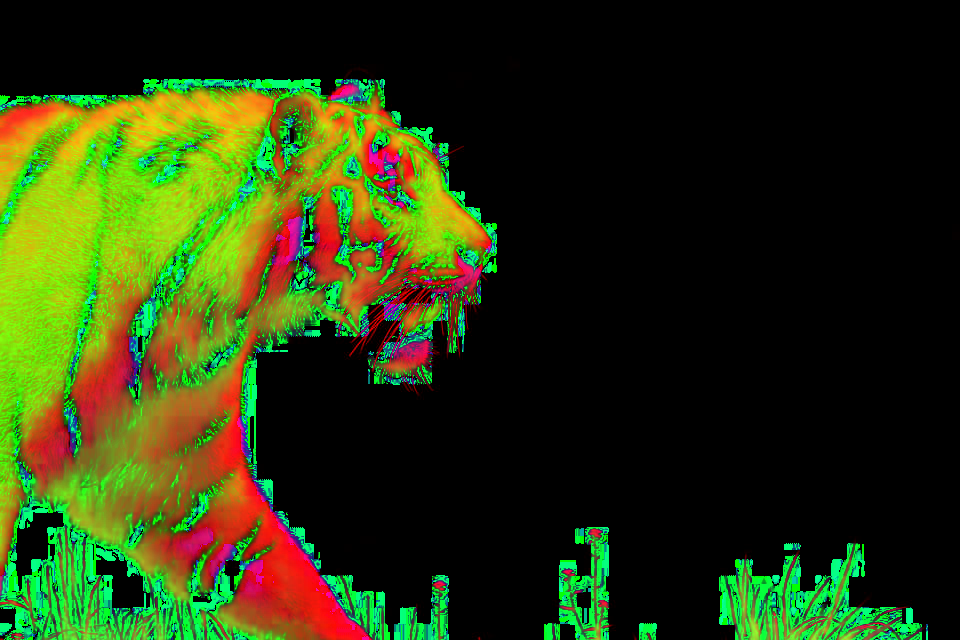

In [ ]:
cv2_imshow(ImHSV)

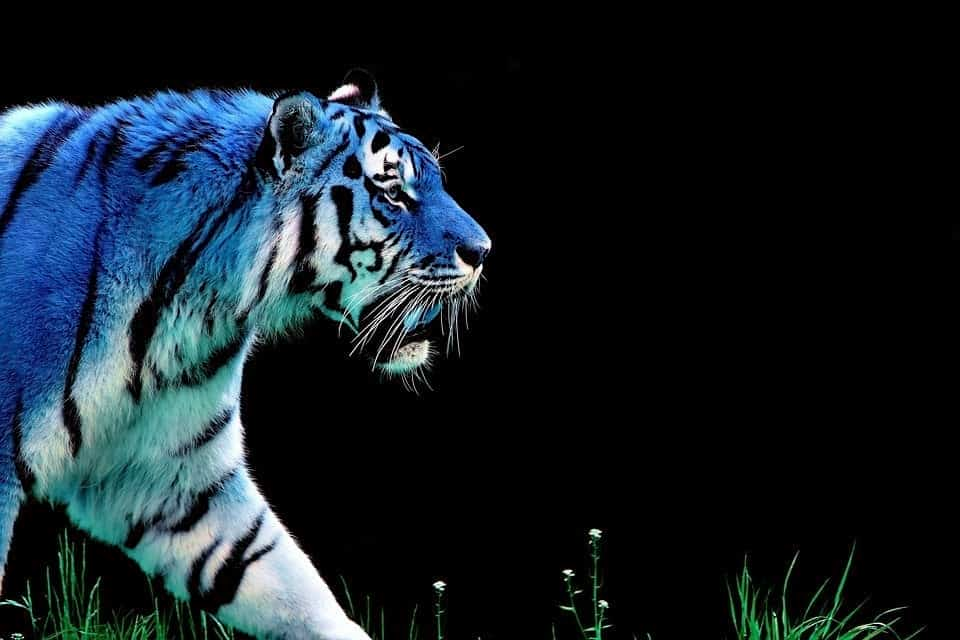

In [ ]:
cv2_imshow(ImRGB)

## Negativo de imagens

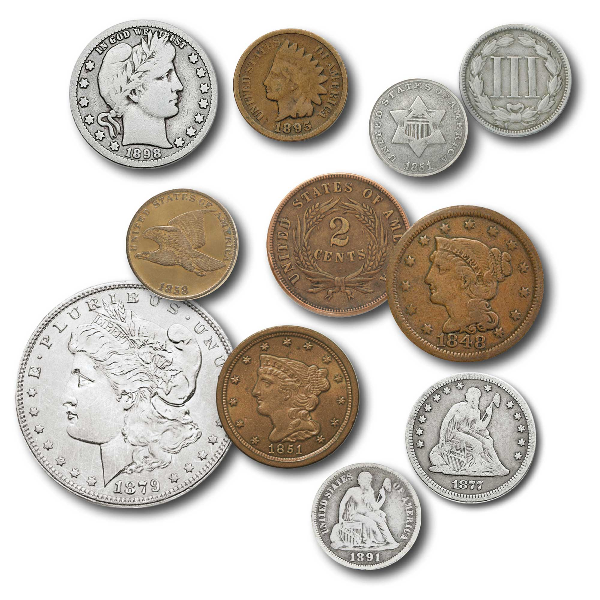

In [ ]:
imagem1 = cv.imread("/content/Imagens/coins.jpg")
imagem1 = cv.resize(imagem1, dsize = (0,0), fx = 0.3, fy = 0.3)
cv2_imshow(imagem1)

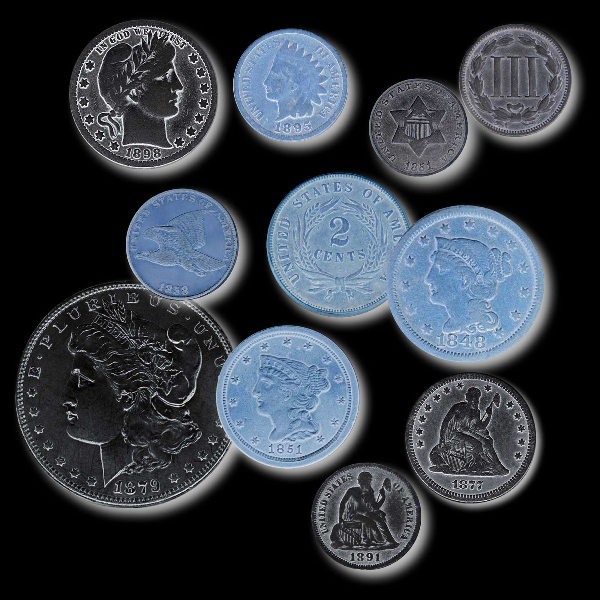

In [ ]:
imagem2 = 255 - imagem1
cv2_imshow(imagem2)

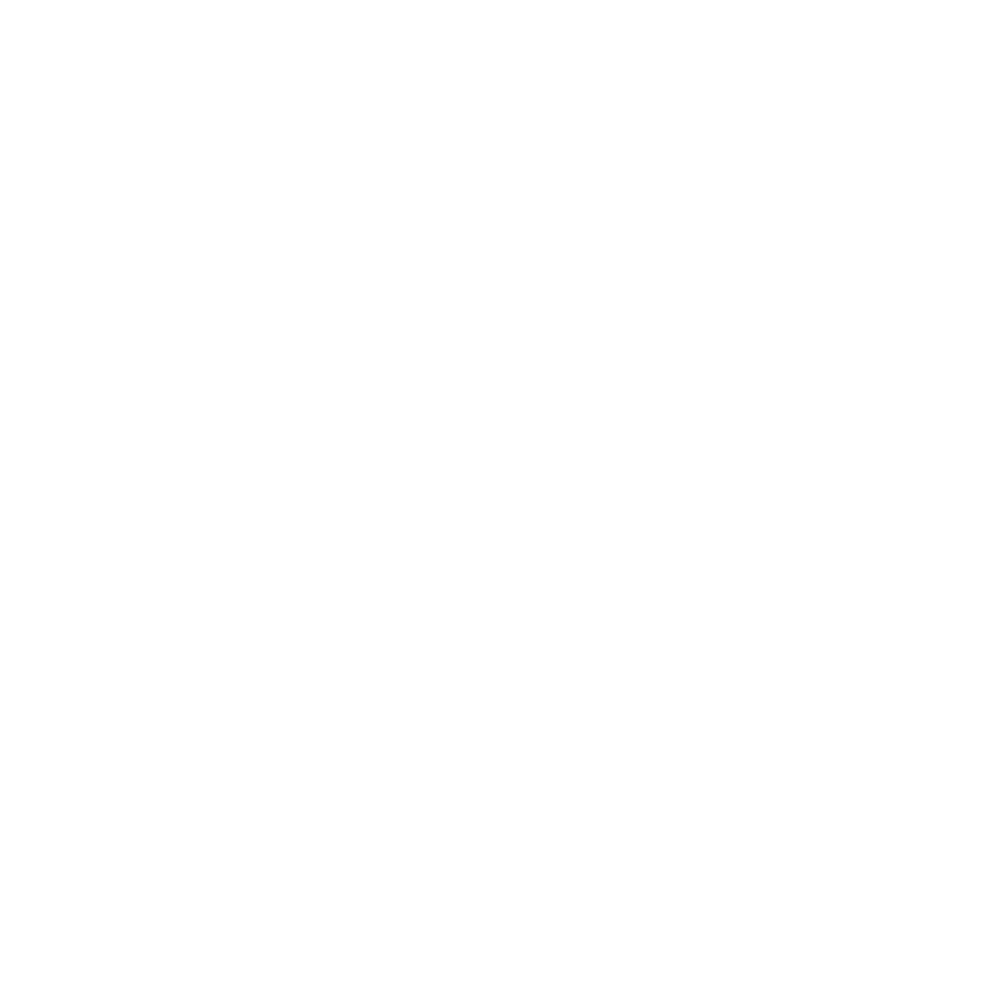

In [ ]:
branco = cv.add(imagem1, imagem2)
cv2_imshow(branco)

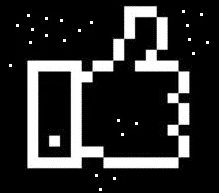

In [ ]:
joinha = cv.imread("/content/Imagens/joinha.png")
cv2_imshow(joinha)

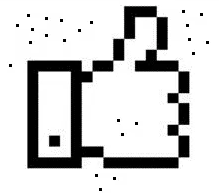

In [ ]:
joinha = 255 - joinha
cv2_imshow(joinha)

## Obtenção de R,G,B



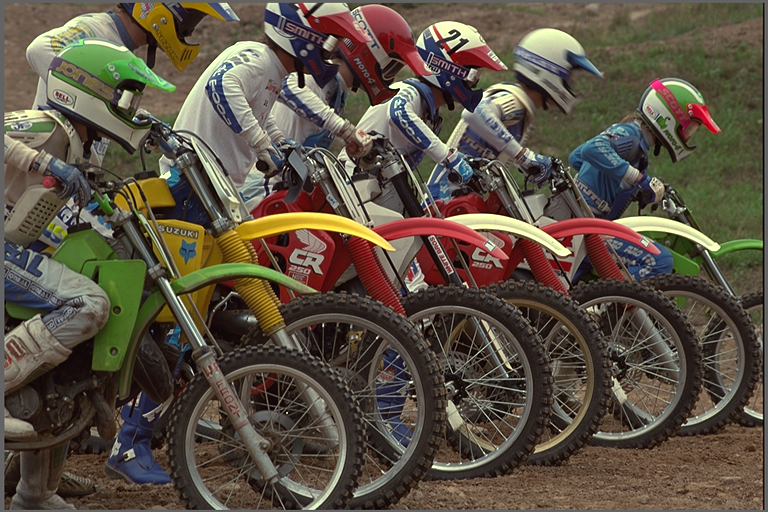

In [ ]:
bicicletas = cv.imread("/content/Imagens/bikes.bmp")
cv2_imshow(bicicletas)

Text(0.5, 1.0, 'Cinza')

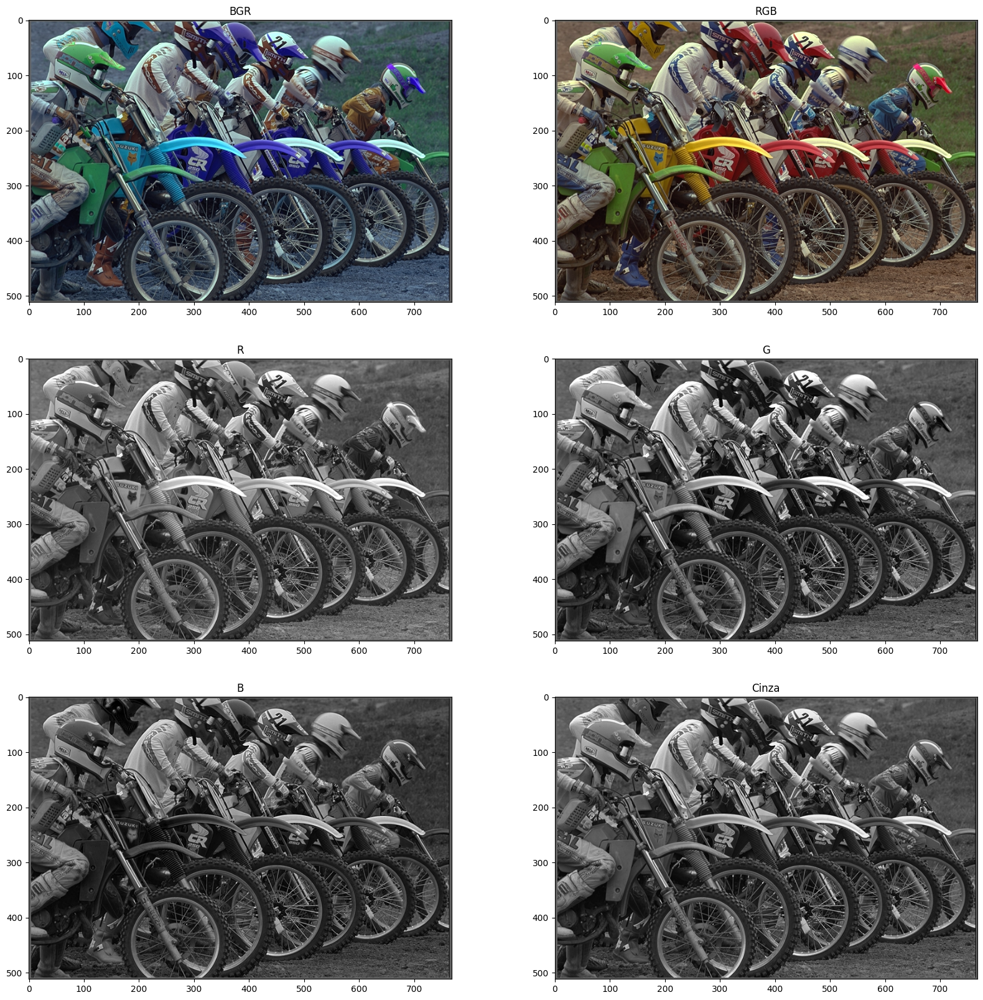

In [ ]:
bicicletas_RGB = cv.cvtColor(bicicletas, cv.COLOR_BGR2RGB)
bicicletas_cinzas = cv.cvtColor(bicicletas, cv.COLOR_RGB2GRAY)

# Modo de organizar as figuras, cria uma figura, e depois configura cada subplot idependentemente
fig = plt.figure(figsize = (20,20))
linhas, colunas = 3, 2

#Seta o ponteiro de plot para o primeiro
#Todas as alterações são utilizadas no plot vigente
fig.add_subplot(linhas, colunas, 1)
plt.imshow(bicicletas)
plt.title("BGR")

fig.add_subplot(linhas, colunas, 2)
plt.imshow(bicicletas_RGB)
plt.title("RGB")

#Retorna imagens que só possuem componentes R, G e B
RIm, GIm, BIm = cv.split(bicicletas_RGB)

fig.add_subplot(linhas, colunas, 3)
plt.imshow(RIm, cmap = 'gray')
plt.title("R")

fig.add_subplot(linhas, colunas, 4)
plt.imshow(GIm, cmap = 'gray')
plt.title("G")

fig.add_subplot(linhas, colunas, 5)
plt.imshow(BIm, cmap = 'gray')
plt.title("B")

fig.add_subplot(linhas, colunas, 6)
plt.imshow(bicicletas_cinzas, cmap = 'gray')
plt.title("Cinza")


## Manipulando HSV


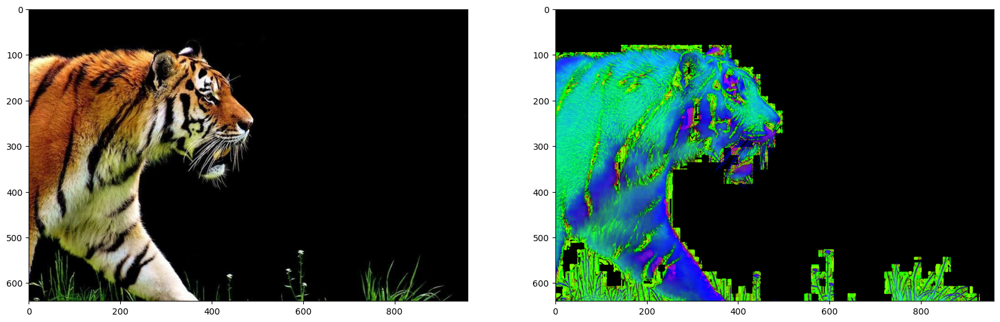

In [ ]:
imagem = cv.imread('/content/Imagens/tigre.jpg')
imagem = cv.cvtColor(imagem, cv.COLOR_BGR2RGB)
imagem_hsv = cv.cvtColor(imagem, cv.COLOR_RGB2HSV)
#Conversão para o HSV

fig = plt.figure(figsize= (20,20))

fig.add_subplot(1, 2, 1)
plt.imshow(imagem)

fig.add_subplot(1, 2, 2)
plt.imshow(imagem_hsv)

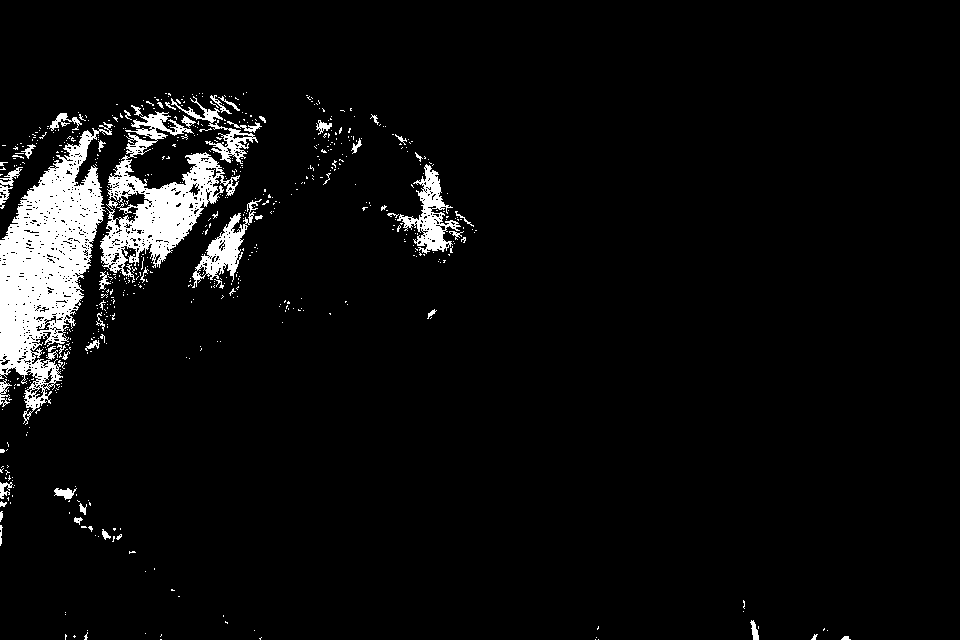

In [ ]:
inferior = (5, 190, 110)
superior = (50, 255, 255)
#Define os limites, usar a L.U.V ou o L.A.B seria mais preciso!
mascara_laranja = cv.inRange(imagem_hsv, inferior, superior) #-> Filtro, define como branco os pixels que atendem ao requerimento especifico
#Mascara da cor laranja no tigre

cv2_imshow(mascara_laranja)

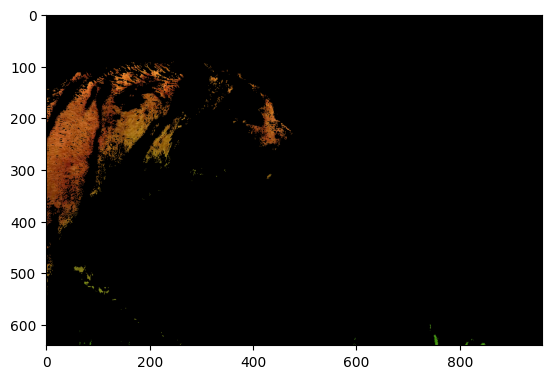

In [ ]:
listras_laranjas = cv.bitwise_and(imagem, imagem, mask = mascara_laranja)
plt.imshow(listras_laranjas)

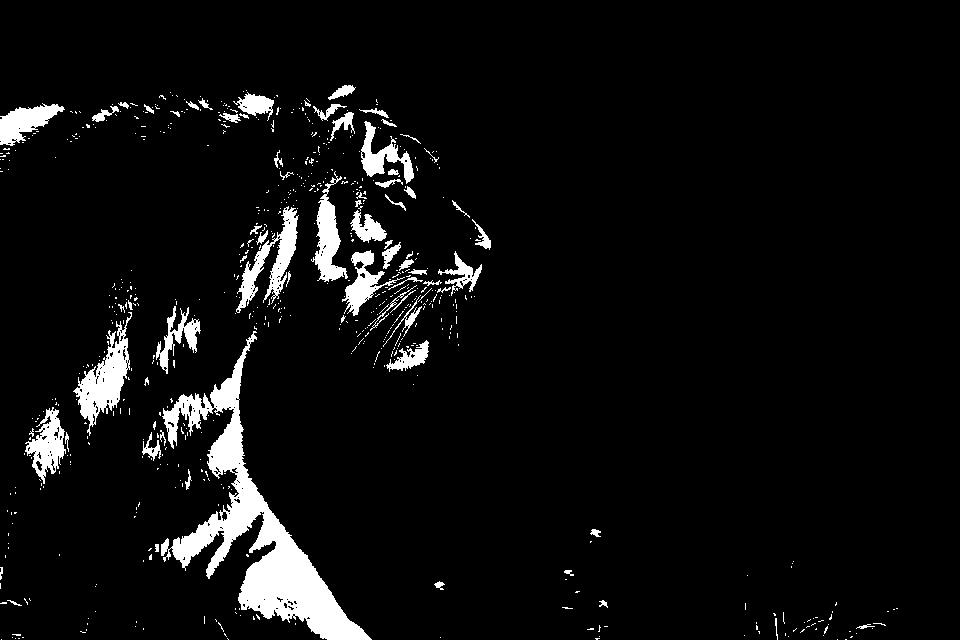

In [ ]:
inferior = (0, 170, 0) #Detecta tons de branco
superior = (255, 255, 255)

mascara_branco = cv.inRange(imagem, inferior, superior) #Cria uma mascara onde somente os pixels brancos são mostrados
cv2_imshow(mascara_branco)

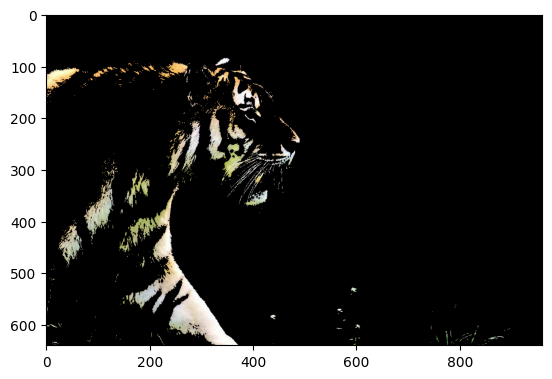

In [ ]:
listras = cv.bitwise_and(imagem, imagem, mask = mascara_branco)
plt.imshow(listras)

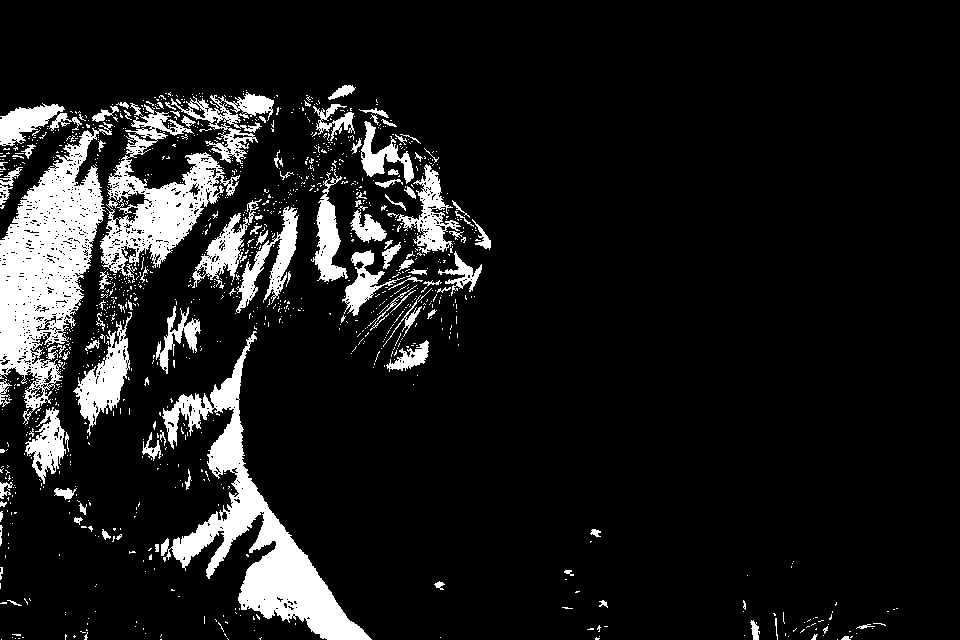

In [ ]:
mascara_junta = cv.add(mascara_laranja, mascara_branco)

cv2_imshow(mascara_junta)

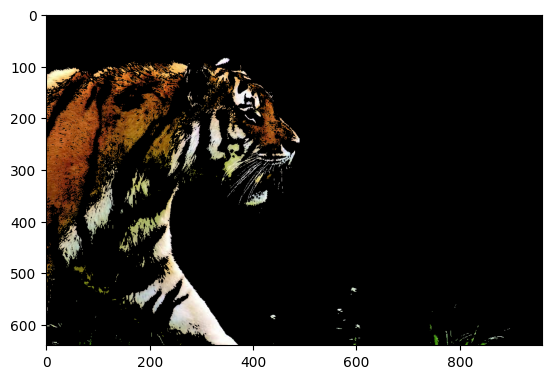

In [ ]:
#Tigre em laranja e branco
tigre = cv.bitwise_and(imagem, imagem, mask = mascara_junta)
plt.imshow(tigre)

## Manipulando CIE LAB

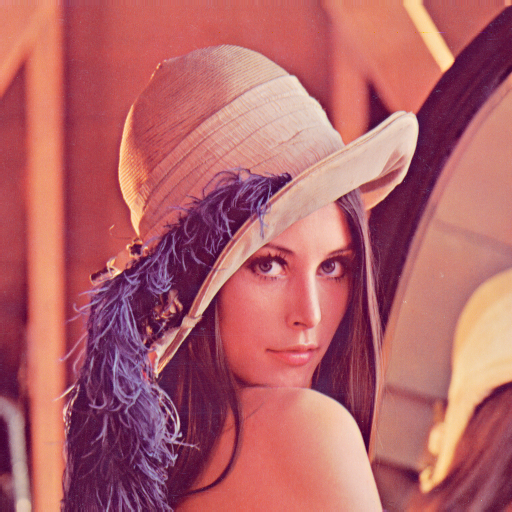

In [ ]:
#Manipulando CIE LAB
estatua = cv.imread("/content/Imagens/Lenna.png")
cv2_imshow(estatua)

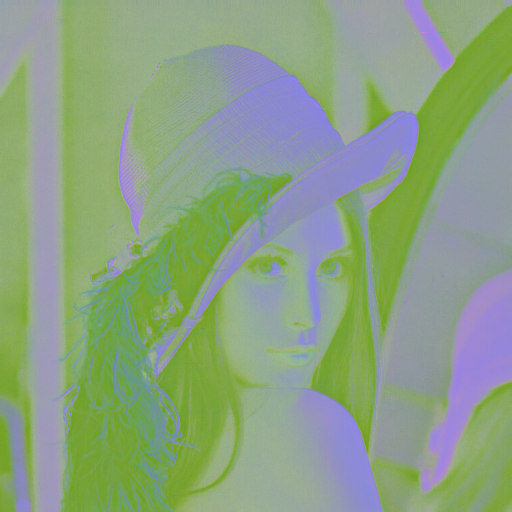

In [ ]:
lab = cv.cvtColor(estatua, cv.COLOR_BGR2Lab)
cv2_imshow(lab)

# Histogramas


Escala das imagem colorida (768, 461, 3)
Escala da imagem cinza (768, 461)


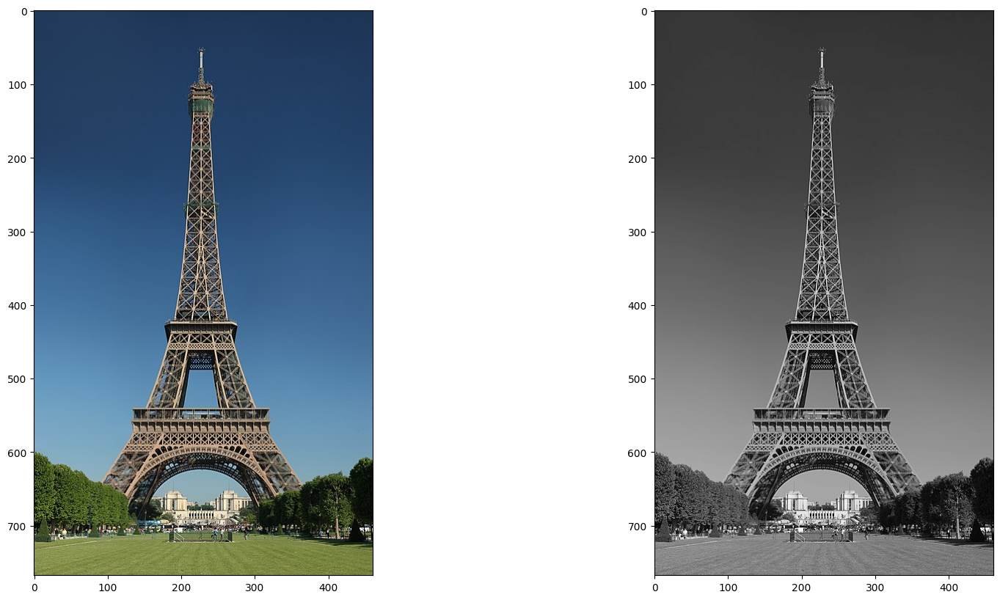

In [ ]:
torre = cv.imread("/content/Imagens/torre_eiffel.jpg")

torre_cinza = cv.cvtColor(torre, cv.COLOR_BGR2GRAY)
torre = cv.cvtColor(torre, cv.COLOR_BGR2RGB)

figura = plt.figure(figsize = (20,10))

figura.add_subplot(1, 2, 1)
plt.imshow(torre)

figura.add_subplot(1, 2, 2)
plt.imshow(torre_cinza, cmap = 'gray')

print("Escala das imagem colorida", torre.shape)
print("Escala da imagem cinza", torre_cinza.shape)

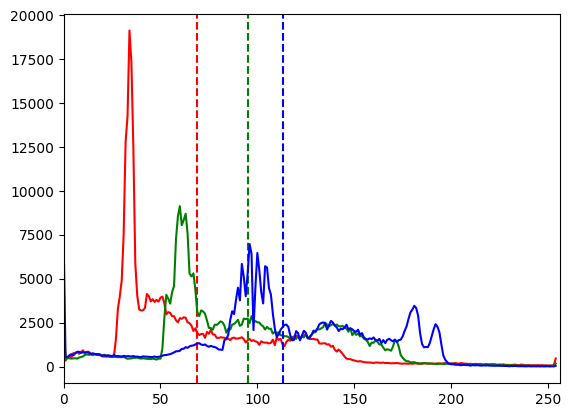

In [ ]:
cores = ('r', 'g', 'b')
#cv.CalcHist(imagem (vetor, pois precisamos de uma lista de valores), dimensão , mascara, qntd_intervalos, intervalo)
#Se dimensão = 0, a cor é R, se for 1 é G, se for 1 é B e assim vai
#Se a mascara existir, só sera considerada a distribuição dos pixels na mascara
#Quantidade_Intervalos, diz a quantidade de intervalos considerados, é uma lista pois
#para cada uma das cores podem ter quantidad de intervalos diferentes
#Intervalo diz qual o valor min e max considerado OBS [min, max)
valores_cores = cv.split(torre)
medias = {cor: int(np.mean(x)) for (cor, x) in zip(cores, valores_cores)} # Media, dicionari do tipo medias[cor] = valor

for i, cor in enumerate(cores):
  histograma = cv.calcHist([torre],[i], None, [255], [0, 256])
  plt.plot(histograma, color = cor)
  plt.axvline(x = medias[cor], linestyle = '--', color = cor)
  plt.xlim([0,256])



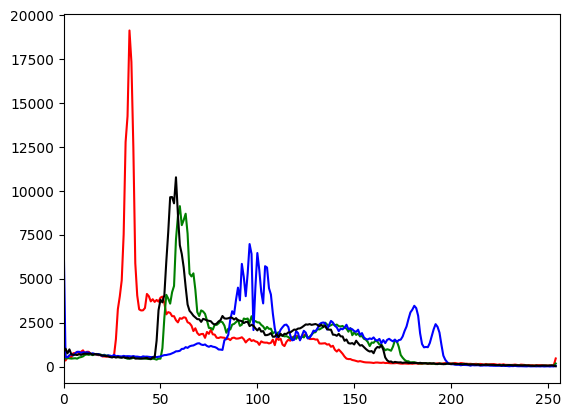

In [ ]:
cores = ('r', 'g', 'b')
#cv.CalcHist(imagem (vetor, pois precisamos de uma lista de valores), dimensão , mascara, qntd_intervalos, intervalo)
#Se dimensão = 0, a cor é R, se for 1 é G, se for 1 é B e assim vai
#Se a mascara existir, só sera considerada a distribuição dos pixels na mascara
#Quantidade_Intervalos, diz a quantidade de intervalos considerados, é uma lista pois
#para cada uma das cores podem ter quantidad de intervalos diferentes
#Intervalo diz qual o valor min e max considerado OBS [min, max)
for i, cor in enumerate(cores):
  histograma = cv.calcHist([torre],[i], None, [255], [0, 256])
  plt.plot(histograma, color = cor)
  plt.xlim([0,256])

histograma_cinza = cv.calcHist([torre_cinza], [0], None, [255], [0,256])
plt.plot(histograma_cinza, color = 'k')

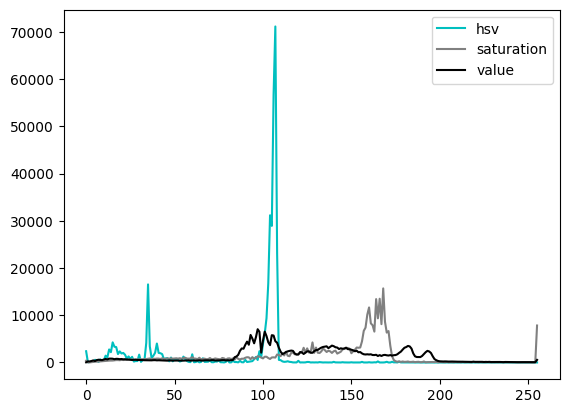

In [ ]:
torre_hsv = cv.cvtColor(torre, cv.COLOR_RGB2HSV)

cores_grafico = ['c', 'gray', 'k']

for i, cor in enumerate(cores_grafico):
  histograma = cv.calcHist([torre_hsv], [i], None, [256], [0,256])
  plt.plot(histograma, color = cor)
plt.legend(['hsv', 'saturation', 'value'])


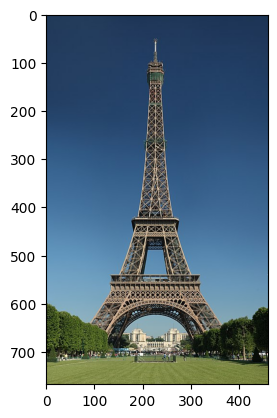

In [ ]:

plt.imshow(torre)

#Contraste

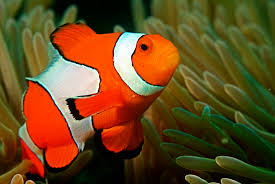

In [ ]:
nemo = cv.imread("/content/Imagens/nemo0.jpg")
cv2_imshow(nemo)

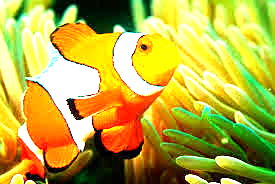

In [ ]:
nemo = cv.imread("/content/Imagens/nemo0.jpg")
nemo_contrastado = nemo * 3.0
cv2_imshow(nemo_contrastado)


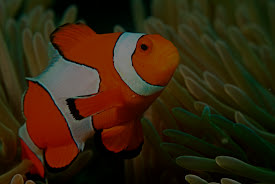

In [ ]:
nemo_descontrastado = nemo * 0.5
cv2_imshow(nemo_descontrastado)

# Filtros Gaussianos


Filtro gaussiano, tem o objetivo de borrar a imagem -> Minimizar altas frequências


---


GaussianBlur(src, ksize,sigma)

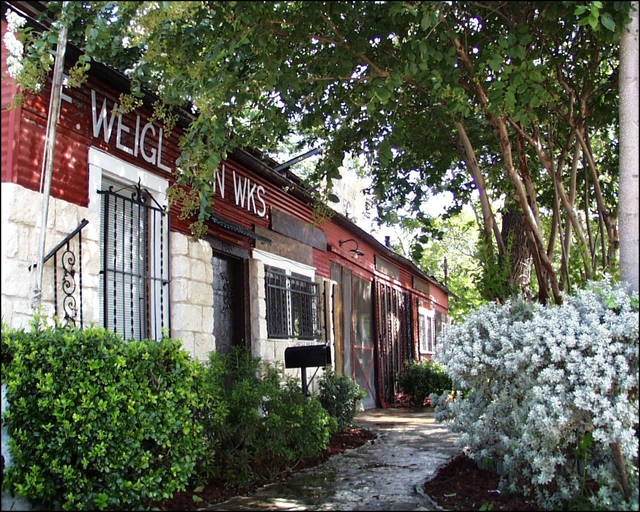

In [ ]:
construcao = cv.imread("/content/Imagens/building2.bmp")
cv2_imshow(construcao)
construcao = cv.cvtColor(construcao, cv.COLOR_BGR2RGB)

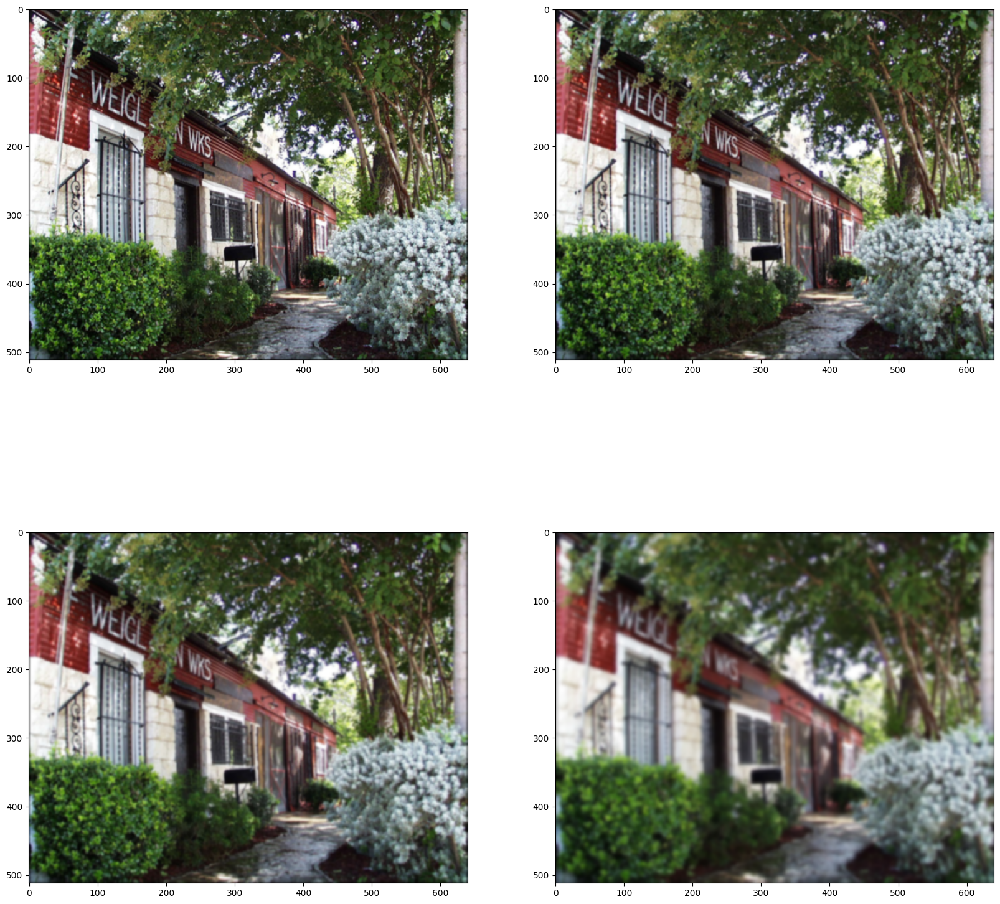

In [ ]:
#cv.GaussianBlur(src (imagem), ksize (ordem da matriz), sigmaX (desvio_x) , [dst (imagem_destino), sigmaY (desvio_y) , borderType (metodo_extensão_borda)])
#Tudo oq está entre os colchetes é opcional
#Desvio y e desvio x representam como a matriz gaussiana será distribuida, se colocar 0, é padronizada
#a ordem da matriz diz quantas convoluções boxes foram realizadas (quanto maior a ordem, mais demorada é a operação)
#Imagem destino

fig = plt.figure(figsize = (20,20))

fig.add_subplot(2, 2, 1)

borramentoG3 = cv.GaussianBlur(construcao, (3,3), 0)
plt.imshow(borramentoG3)

fig.add_subplot(2, 2, 2)
borramentoG5 = cv.GaussianBlur(construcao, (5,5), 0)
plt.imshow(borramentoG5)

fig.add_subplot(2, 2, 3)
borramentoG7 = cv.GaussianBlur(construcao, (7,7), 0)
plt.imshow(borramentoG7)

fig.add_subplot(2, 2, 4)
borramentoG15 = cv.GaussianBlur(construcao, (15,15), 0)
plt.imshow(borramentoG15)


# Filtros Arbitrários e de derivadas

Função filter2D
```
cv.filter2D(imagem, profundidade, filtro)
```
* Imagem -> Imagem a ser filtrada
* profundidade -> Diz respeito a quantos bits serão usados para representar cada cor da imagem final. Caso coloque "-1" a quantidade de bits será a mesma que a imagem original, caso queira mudar é possivel utilizar "cv.CV_8U" pra mudar a imagem pra 8 bits
* Filtro -> Matriz "kernel", o filtro em si

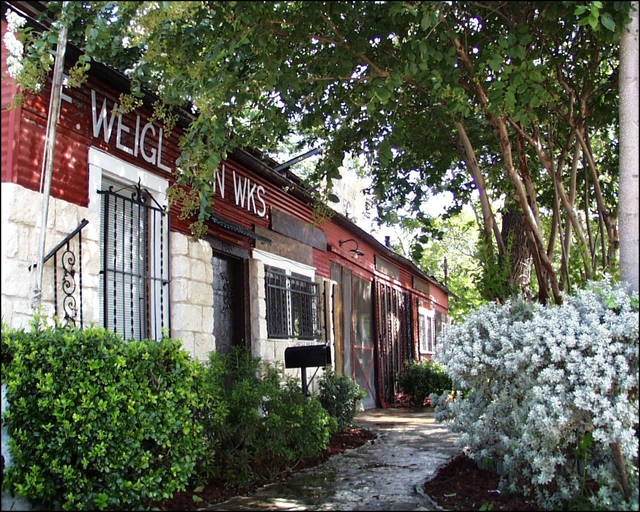

In [ ]:
construcao = cv.imread("/content/Imagens/building2.bmp")
cv2_imshow(construcao)
construcao = cv.cvtColor(construcao, cv.COLOR_BGR2RGB)

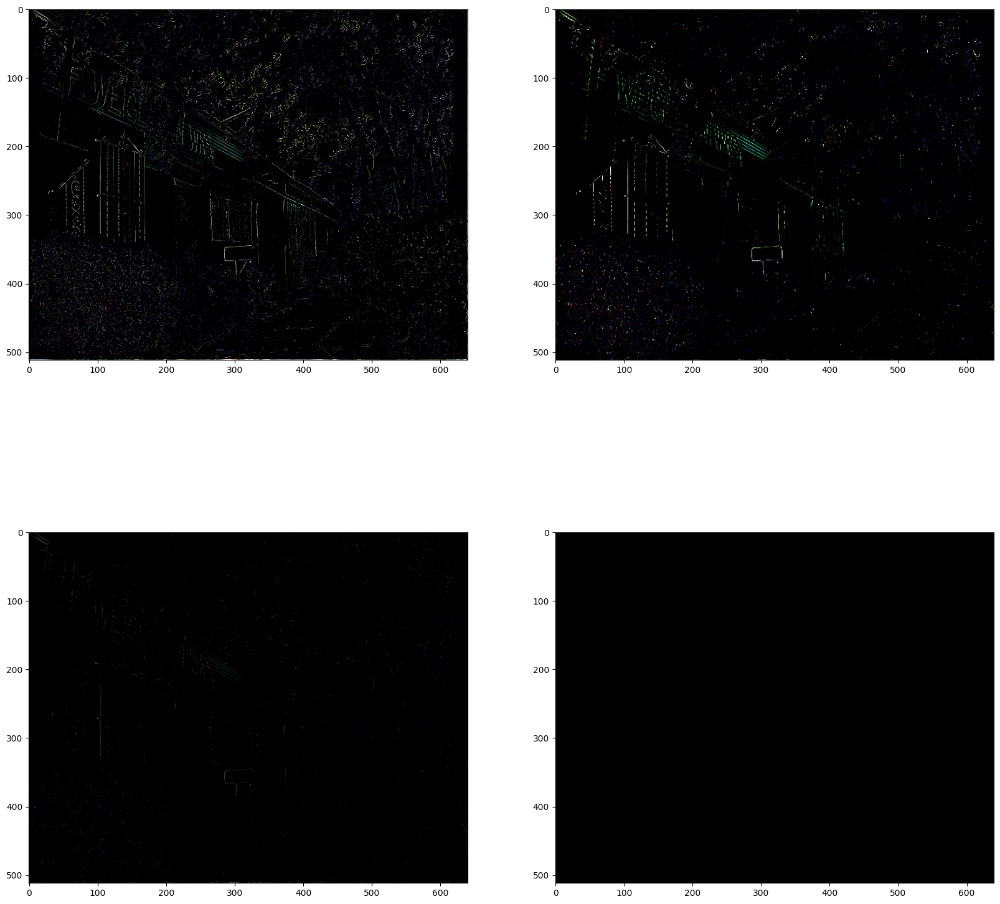

In [ ]:


laplac = np.array([[0, 1, 0],
                      [1, -4, 0],
                      [0, 1, 0]])

laplac4 = np.array([[0, 1, 1, 0],
                    [1,-4,-4, 1],
                    [1,-4,-4, 1],
                    [0, 1, 1, 0]])


fig = plt.figure(figsize = (20, 20))

fig.add_subplot(2, 2, 1)
img1 = cv.filter2D(construcao, -1, laplac)
plt.imshow(img1, cmap = 'gray')

fig.add_subplot(2, 2, 2)
img2 = cv.filter2D(construcao, -1, laplac4)
plt.imshow(img2, cmap = 'gray')

fig.add_subplot(2, 2, 3)
img3 = cv.filter2D(borramentoG3, -1, laplac)
plt.imshow(img3, cmap = 'gray')

fig.add_subplot(2, 2, 4)
img4 = cv.filter2D(borramentoG15, -1, laplac4)
plt.imshow(img4, cmap = 'gray')

#A imagem 3 e 4 ficam praticamente pretas pois o filtro gaussiano diminui as altas frequências
#O filtro laplaciano atenua as regiões de alta frequência ....


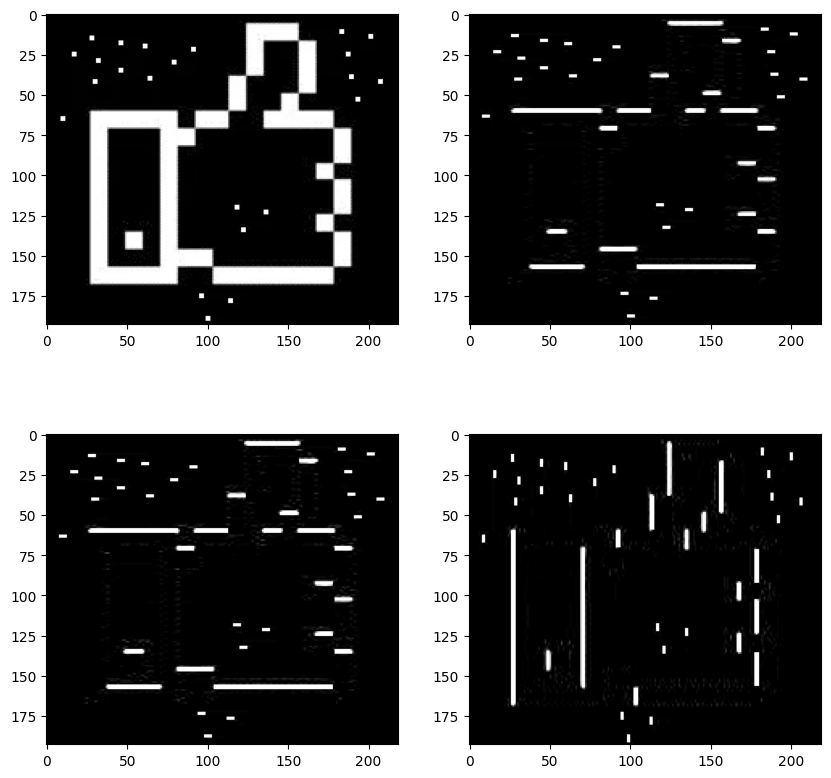

In [ ]:
#Filtro de derivadas, gera um borramento no eixo x ou no eixo y!
joinha = cv.imread("/content/Imagens/joinha.png")

#Perceba que na hora da convolução o filtro considera a parte de CIMA e a parte de BAIXO da regiao do filtro.
#Se a parte de cima for igual a de baixo (sem alta alteração), o resultado da convolução no ponto e 0
#Porém, se for diferente, a linha de baixo não anula a de cima, gerando um valor diferente de 0
#Detecta  borda nas horizontais!

bordas_x = np.array(     [[-1, -1, -1],
                          [0, 0, 0],
                          [1, 1, 1]])

bordas_x2 = np.array(    [[-1, -2, -1],
                          [0, 0, 0],
                          [1, 2, 1]])

bordas_y = np.array([     [-1, 0, 1],
                          [-2, 0, 2],
                          [-1, 0, 1]])

fig = plt.figure(figsize = (10, 10))


fig.add_subplot(2, 2, 1)
plt.imshow(joinha)

fig.add_subplot(2, 2, 2)
img1 = cv.filter2D(joinha, -1, bordas_x)
plt.imshow(img1)

fig.add_subplot(2, 2, 3)
img2 = cv.filter2D(joinha, -1, bordas_x2)
plt.imshow(img2)

fig.add_subplot(2, 2, 4)
img3 = cv.filter2D(joinha, -1, bordas_y)
plt.imshow(img3)

#Perceba que a imagem tem certos ruidos, pois a cor branca não é uniforme, temos diferença de tons de branco nessa região ond efoi ressaltado


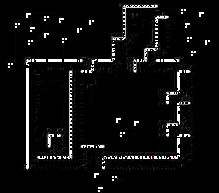

In [ ]:
#OUTRA forma de aplicar esses filtros e com a funcao cv2.sobel(src(imagem), deppth(bits), dx (1 se detecta borda horizontal), dy (1 se detecta borda vertical))
#usar dx e dy nesse caso não funcionou mt bem, preciso entender o porque!!!
bordas = img3 + img1
cv2_imshow(bordas)

# Filtro CANNY


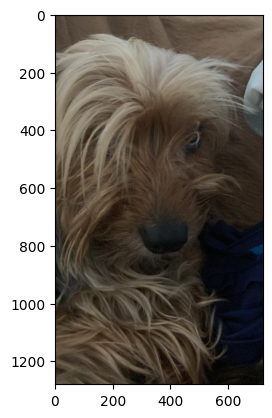

In [ ]:
#upload = files.upload()
affonso_original = cv.imread("/content/affonso.jpeg")
affonso_original = cv.cvtColor(affonso_original, cv.COLOR_BGR2RGB)
plt.imshow(affonso_original)

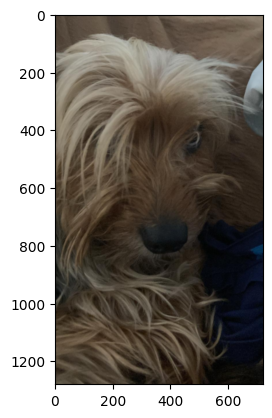

In [ ]:
affonso = cv.GaussianBlur(affonso_original, (7,7), sigmaX = 1, sigmaY = 1) #Aplicando um filtro gaussiano, faz parte do algoritmo ótimo de canny
plt.imshow(affonso)

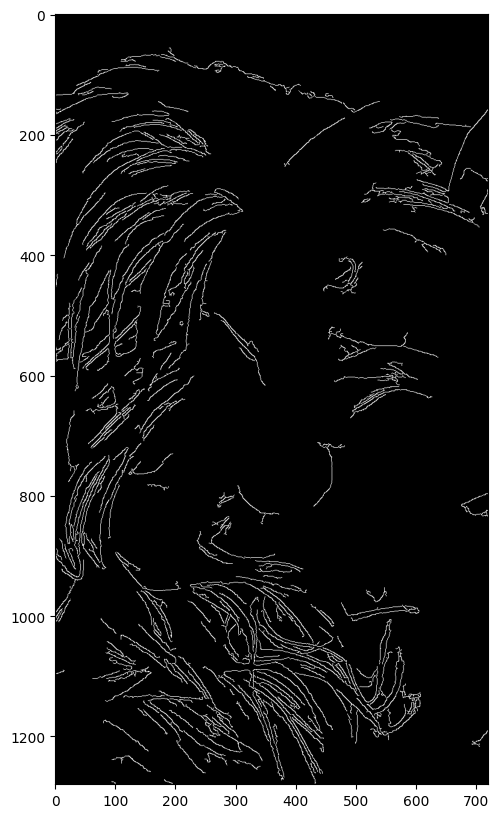

In [ ]:

figure = plt.figure(figsize = (10,10))
bordas = cv.Canny(affonso, 20, 110) #Imagem, numero do treshold pros fracos e pros fortes (intermediarios são candidatos)
plt.imshow(bordas, cmap = 'gray')

#Dilatação


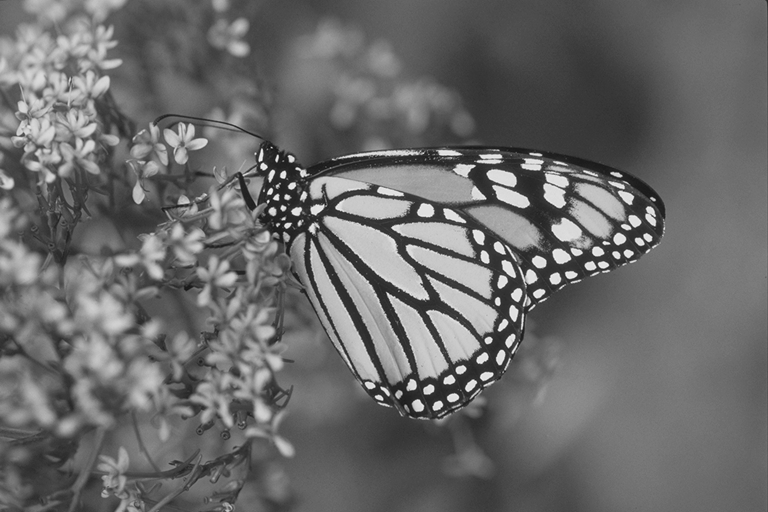

In [ ]:
#imagem_dilatada = cv.dilate(imagem, elemento estrutural, iterations = n) n interações
imagem = cv.imread('/content/Imagens/monarch.bmp', 0) #Flag no segundo parâmetro diz que a imagem será extraida em tons de cinza
cv2_imshow(imagem)

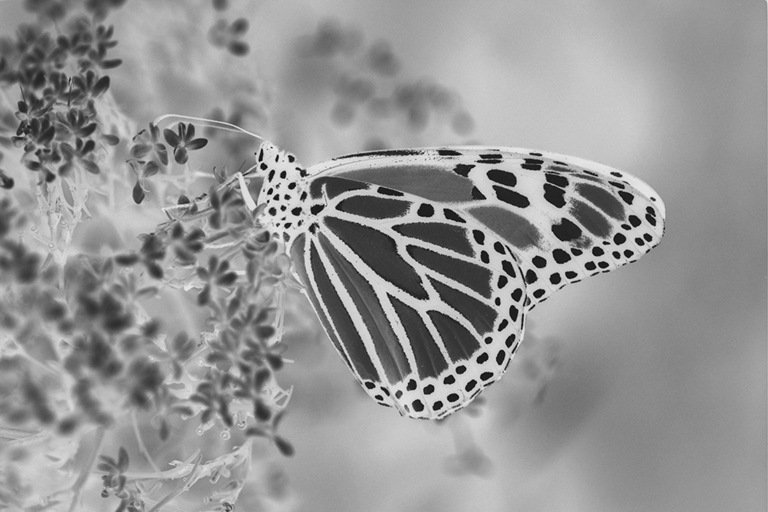

In [ ]:
#Perceba que as BORDAS estão em preto, se fizermos dilatação não será um resultado interessante
imagem_neg = ~imagem
cv2_imshow(imagem_neg)

Text(0.5, 1.0, 'Imagem negativa dilata e revertida')

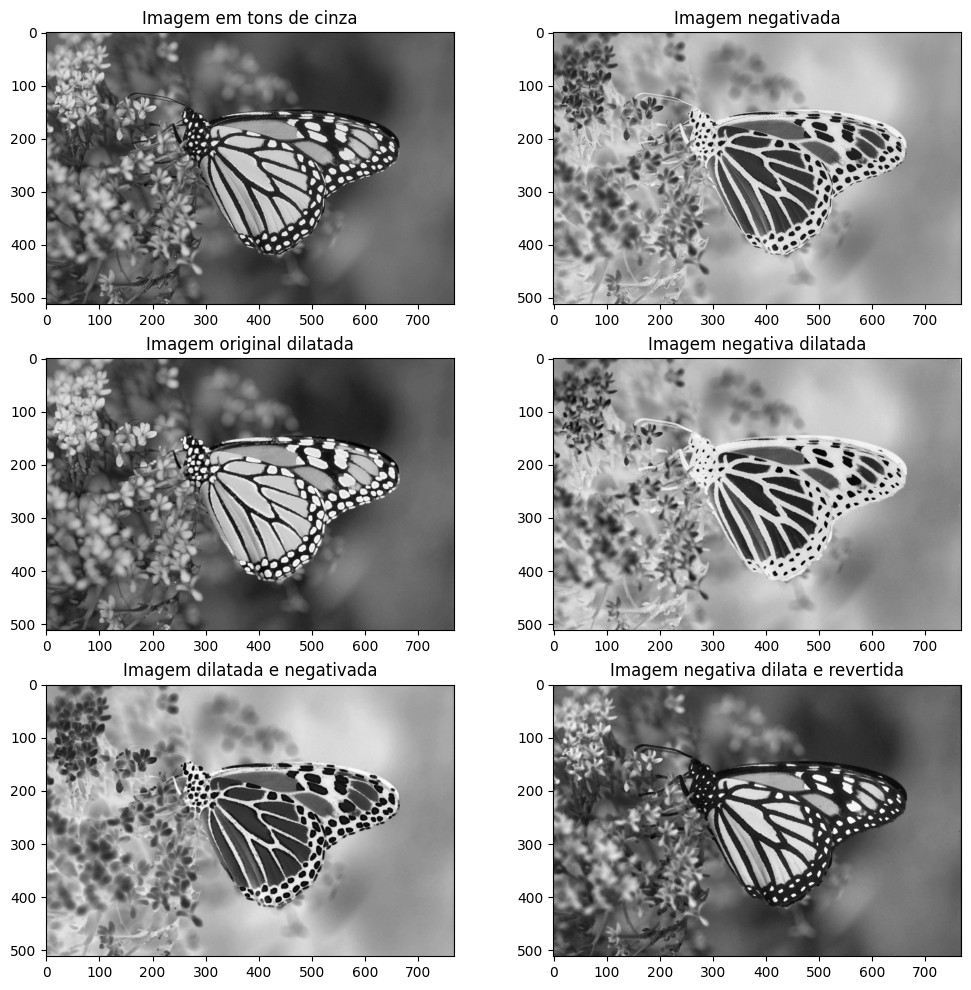

In [ ]:
fig = plt.figure(figsize = (12, 12))
unitario = np.array([[1, 1, 1],[1, 1, 1],[1, 1, 1]])


fig.add_subplot(3, 2, 1)
plt.imshow(imagem, cmap = 'gray')
plt.title("Imagem em tons de cinza")

fig.add_subplot(3, 2, 2)
plt.imshow(imagem_neg, cmap = 'gray')
plt.title("Imagem negativada")

fig.add_subplot(3, 2, 3)

dilatado = cv.dilate(imagem, unitario, iterations = 1)
plt.imshow(dilatado, cmap = 'gray')
plt.title("Imagem original dilatada")

fig.add_subplot(3, 2, 4)

dilatado_neg = cv.dilate(imagem_neg, unitario, iterations = 1)
plt.imshow(dilatado_neg, cmap = 'gray')
plt.title("Imagem negativa dilatada")

fig.add_subplot(3, 2, 5)
plt.imshow(~dilatado, cmap = 'gray')
plt.title("Imagem dilatada e negativada")

fig.add_subplot(3, 2, 6)
plt.imshow(~dilatado_neg, cmap = 'gray')
plt.title("Imagem negativa dilata e revertida")




#Erosão

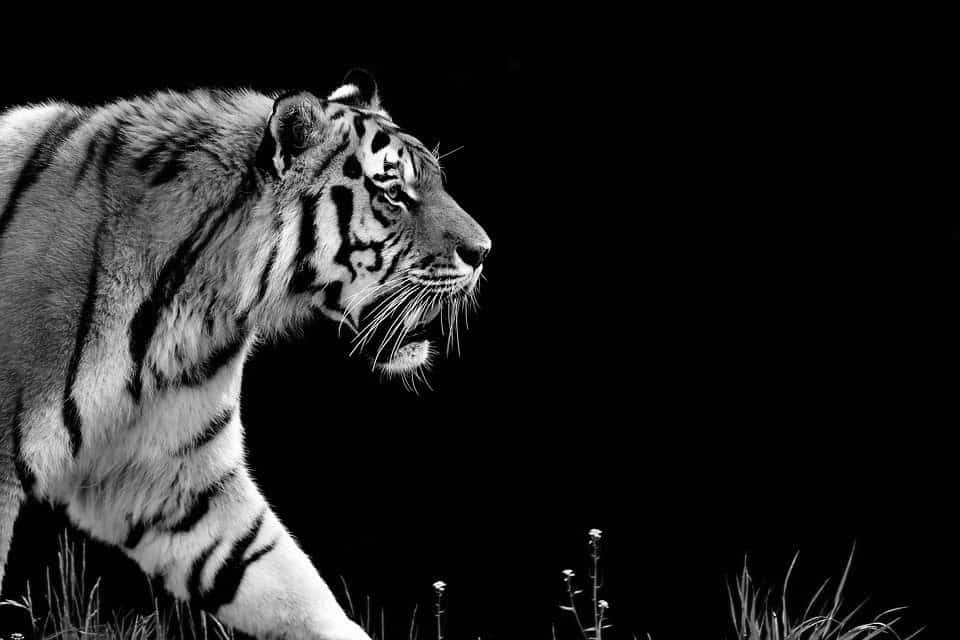

In [ ]:
imagem = cv.imread("/content/Imagens/tigre.jpg", 0)
cv2_imshow(imagem)

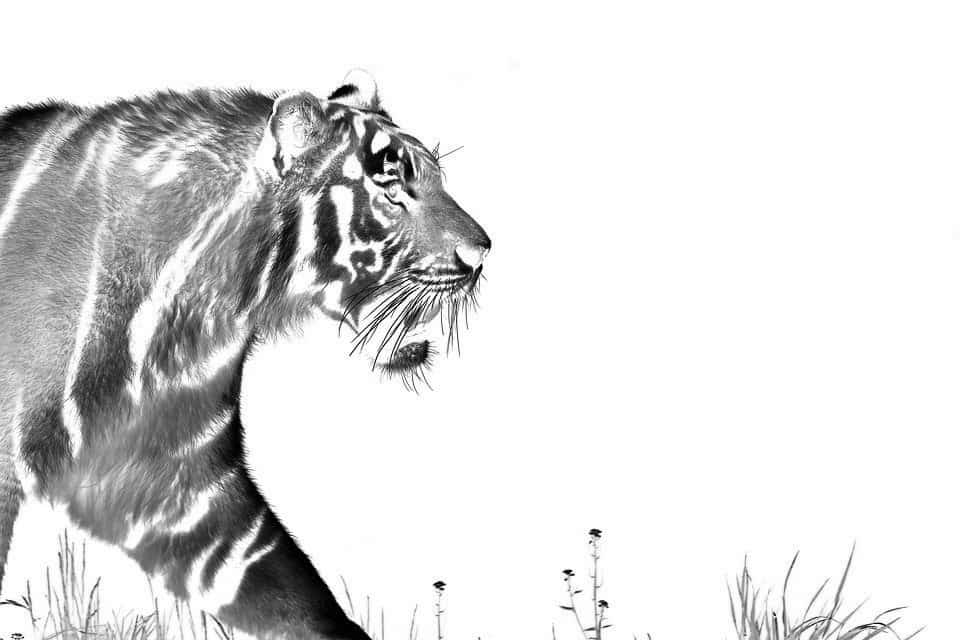

In [ ]:
imagem_neg = ~imagem
cv2_imshow(imagem_neg)

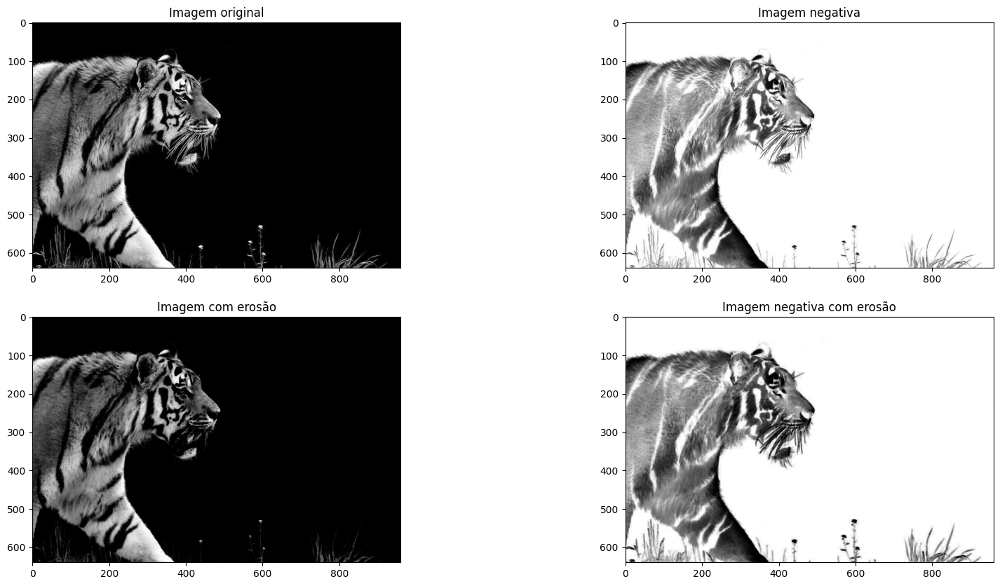

In [ ]:
fig = plt.figure(figsize=(20, 10))

fig.add_subplot(2,2, 1)
plt.imshow(imagem, cmap = 'gray')
plt.title("Imagem original")


fig.add_subplot(2,2,2)
plt.imshow(imagem_neg, cmap = 'gray')
plt.title("Imagem negativa")

fig.add_subplot(2, 2, 3)
erosao = cv.erode(imagem, unitario, iterations= 1 )
plt.title("Imagem com erosão")

plt.imshow(erosao, cmap = 'gray')

fig.add_subplot(2, 2, 4)
erosao_neg = cv.erode(imagem_neg, unitario, iterations= 1 )
plt.title("Imagem negativa com erosão")
plt.imshow(erosao_neg, cmap = 'gray')

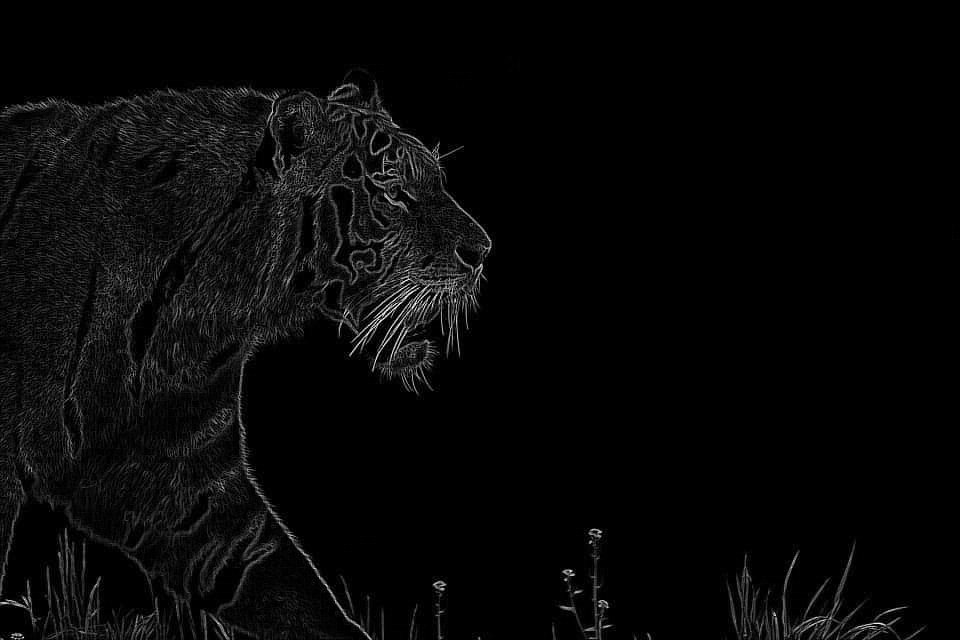

In [ ]:
#conseguindo bordas apartir da seguinte propriedade
bordas = imagem - erosao
cv2_imshow(bordas)

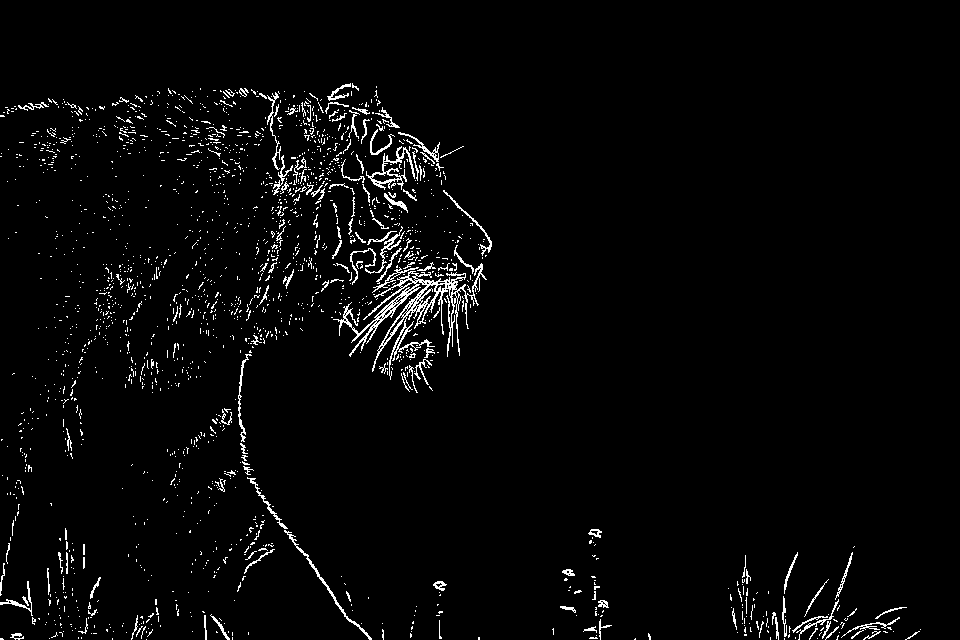

In [ ]:
ret, bordas_mais_fortes = cv.threshold(bordas, 60, 255, cv.THRESH_BINARY)
cv2_imshow(bordas_mais_fortes)

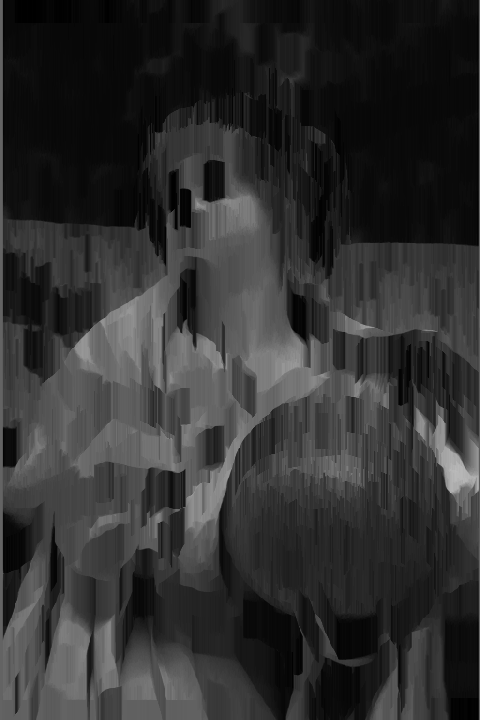

In [ ]:
imagem = cv.imread("/content/Imagens/statue.bmp", 0)

size = 20
escala_h = imagem.shape[0]
len_linha_v = escala_h // size

vertical = cv.getStructuringElement(cv.MORPH_RECT, (1,len_linha_v)) #Cria um elemento estruturante retangular de dimensoes de 1xtam_linha
#O método utilizado para adquirir o tamanho da linha vertical leva em consideração uma proporção das linhas com o comprimento da imagem

linhas_v = cv.erode(imagem, vertical, iterations = 1)

cv2_imshow(linhas_v)

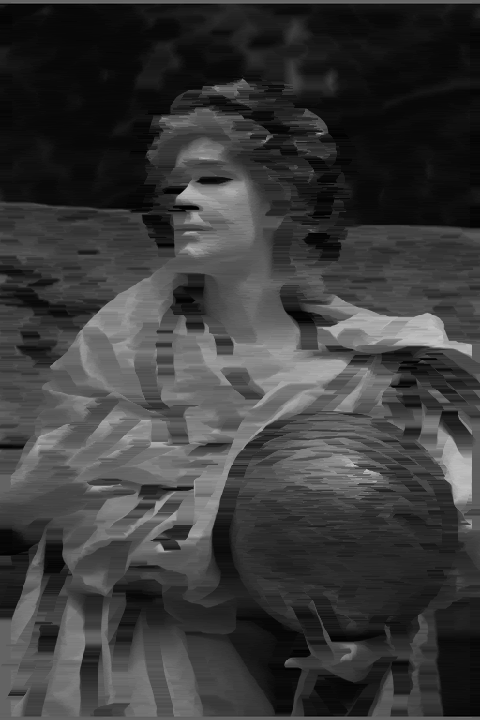

In [ ]:
escala_v = imagem.shape[1]
len_linha = escala_v//30

horizontal = cv.getStructuringElement(cv.MORPH_RECT, (len_linha, 1))

linhas_h = cv.erode(imagem, horizontal, iterations= 1)
cv2_imshow(linhas_h)

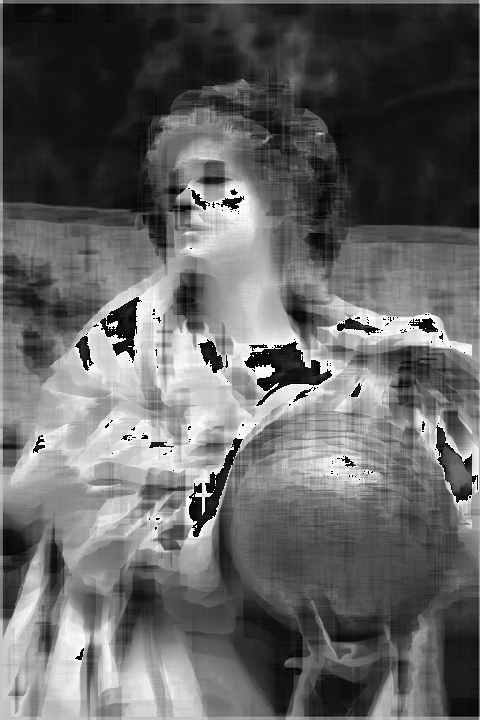

In [ ]:
cv2_imshow(linhas_h+linhas_v)